# Going Deeper 04 Image Segmentation  
###### 온라인 코어 2기 박수경

## Intro

이번 과제에서는 Image segmentation을 통해서 사진에 섈로우 포커스를 적용한 것처럼 만들어 보기로 한다.  
전체적인 흐름은 다음과 같다.  
1) 이미지를 불러 온다.  
2) pixellib 라이브러리, DeepLab 알고리즘(DeepLab v3+)을 사용한다. (pre-trained model을 사용하는 task)  
3) segmentation model deepLab으로 이미지를 픽셀단위로 레이블링한다. 그 중 사람(idx 15)인 부분만을 추출할 수 있다.  
4) 사람으로 레이블링된 부분은 원본 이미지를 보여주고, 아닌 부분은 blur 처리한 이미지를 보여줌으로서 섈로 포커스 효과를 줄 수 있다.  
5) 모델이 구분할 수 있는 사람외의 다른 클래스에 대해 위 내용을 적용해본다.  
6) 크로마키 배경을 합성한다.  
7) 결과물의 문제점을 찾는다.  
8) 개선방안을 제시한다.  

![흐름도](https://d3s0tskafalll9.cloudfront.net/media/images/E-14-2.max-800x600_jKvxGUl.png)  
<center>(ref.1)</center>

## 필요한 라이브러리, 모듈, 이미지 파일 준비

In [1]:
import os
import urllib
import cv2
import numpy as np
from pixellib.semantic import semantic_segmentation
from matplotlib import pyplot as plt

print('import 완료')

import 완료


- `Semantic segmentation`은 `입력 영상에 주어진 각각의 픽셀에 대해서 class label을 할당하는 것을 목표`로 한다. 이번 과제에서 사용하는 모델은 PASCAL VOC 데이터로 학습된 모델으로, 구분할 수 있는 클래스는 background 제외하고 20개이다. 그 중 사람(인물)의 레이블은 15이다.

>cf. PASCAL VOC Challange 성능평가방법:  
mIoU (mean Intersection over Union)  
 

- DeepLab은 atrous convolution을 적용해 성능을 높이고 있다. V2에서는 multi-scale context를 파악하기 위해 Atrous Spatial Pyramid Pooling (ASPP)라는 방법을 제안했다. V3에서 기본적인 ResNet 구조에 atrous convolution을 결합하는 것으로 feature map을 조금 더 밀도있게 만들 수 있었다. 최근에는 V3+에서 separable convolution, atrous convolution을 결합하여 atrous separable convolution이라는 방법을 제시하고 있다.

### Atrous Convolution
![ref.1](https://bloglunit.files.wordpress.com/2018/07/atrous.png?w=644&h=308)  
Atrous convolution 는 그림과 같이 `필터 내부에 빈 공간`을 가지고 있다.  
얼마나 빈 공간을 둘 지 결정하는 파라미터인 rate(r)을 설정하게 되는데 r=1일 경우 기존 convolution과 동일하고, r이 커질 수록 빈 공간이 넓어진다는 것을 의미한다.

이는 `기존 convolution과 동일한 양의 파라미터와 계산량을 유지`하면서도, `field of view(한 픽셀이 볼 수 있는 영역)를 크게` 잡을 수 있다는 이점이 있다. 보통 semantic segmentation에서 높은 성능을 내기 위해서는 convolutional neural network의 마지막에 존재하는 한 픽셀이 입력값에서 어느 크기의 영역을 커버할 수 있는지를 결정하는 receptive field 크기가 중요하다. Atrous convolution 사용으로 `파라미터 수를 늘리지 않으면서도 receptive field를 크게 키울 수 있다.`

In [2]:
model_dir = os.getenv('HOME')+'/aiffel/human_segmentation/models' 
model_file = os.path.join(model_dir, 'deeplabv3_xception_tf_dim_ordering_tf_kernels.h5') 
model_url = 'https://github.com/ayoolaolafenwa/PixelLib/releases/download/1.1/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5' 

urllib.request.urlretrieve(model_url, model_file)

('/aiffel/aiffel/human_segmentation/models/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5',
 <http.client.HTTPMessage at 0x7eff96e2aa30>)

In [3]:
model = semantic_segmentation()
model.load_pascalvoc_model(model_file) 

### PASCAL VOC

In [4]:
# pascalvoc 데이터의 라벨종류
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
len(LABEL_NAMES)

21

### 이미지 불러오기

(768, 1024, 3)


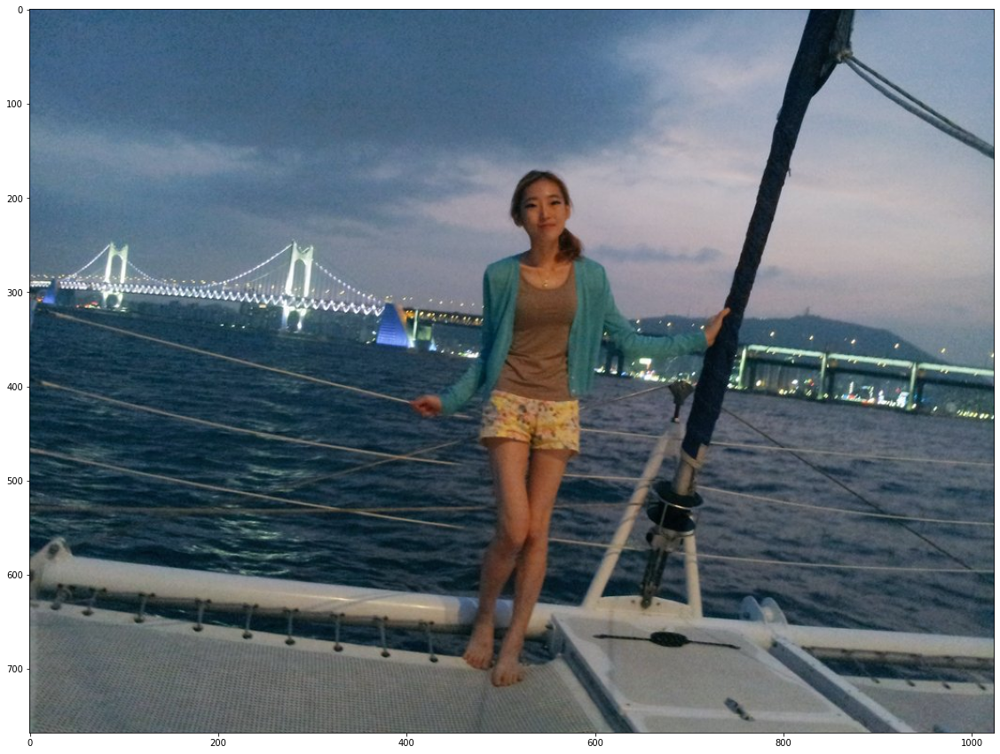

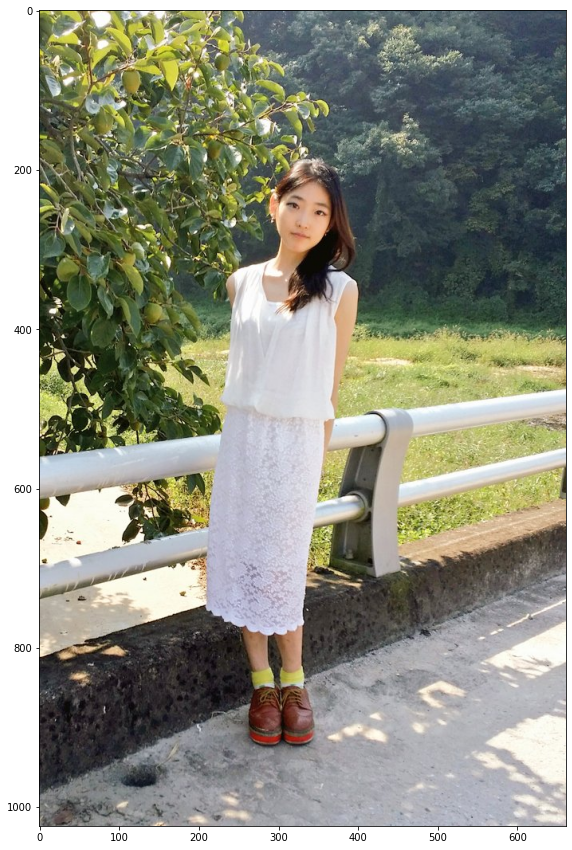

In [5]:
img_path_1 = 'img/img1.jpg'
img_path_2 = 'img/img2.jpg'
img_path_3 = 'img/cow.jpg'
img_path_4 = 'img/cow2.jpg'
img_orig_1 = cv2.imread(img_path_1)
img_orig_2 = cv2.imread(img_path_2) 
img_orig_3 = cv2.imread(img_path_3) 
img_orig_4 = cv2.imread(img_path_4) 

print(img_orig_1.shape)
plt.rcParams["figure.figsize"] = (20, 15)
plt.imshow(cv2.cvtColor(img_orig_1, cv2.COLOR_BGR2RGB))
plt.show()
plt.imshow(cv2.cvtColor(img_orig_2, cv2.COLOR_BGR2RGB))
plt.show()

![](img/cow.jpg)  
![](img/cow2.jpg)

In [6]:
segvalues_1, output_1 = model.segmentAsPascalvoc(img_path_1)
segvalues_2, output_2 = model.segmentAsPascalvoc(img_path_2)

segvalues_3, output_3 = model.segmentAsPascalvoc(img_path_3)
segvalues_4, output_4 = model.segmentAsPascalvoc(img_path_4)


segmentAsPascalvoc() : https://pixellib.readthedocs.io/en/latest/Image_pascal.html?highlight=segmentaspascalvoc 참고

### 생성된 마스크 출력

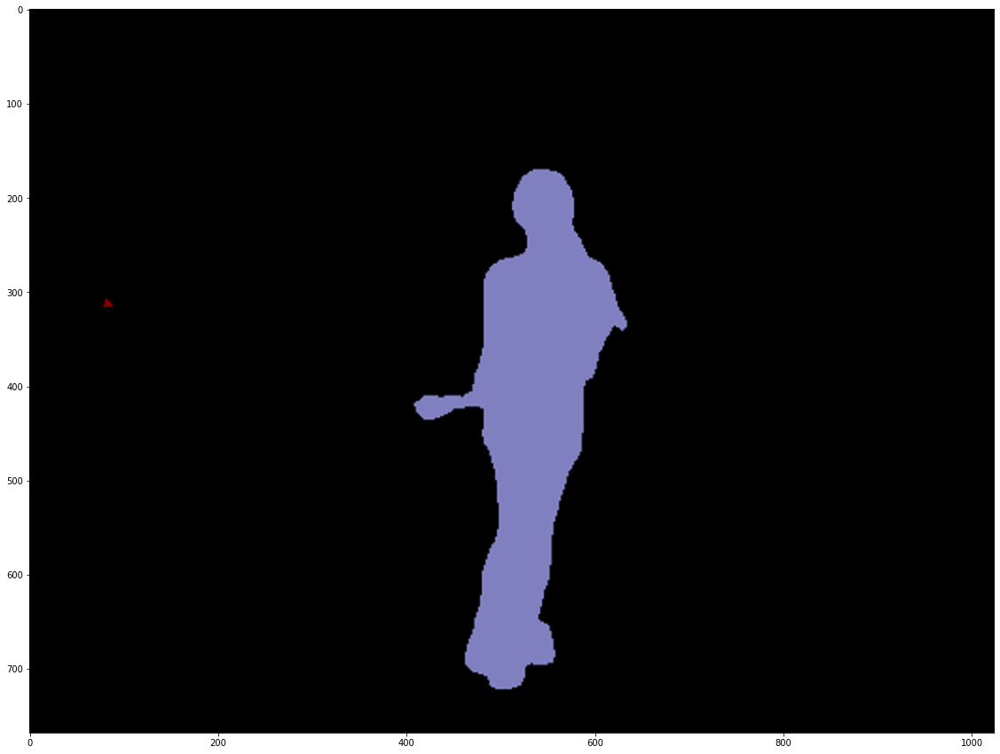

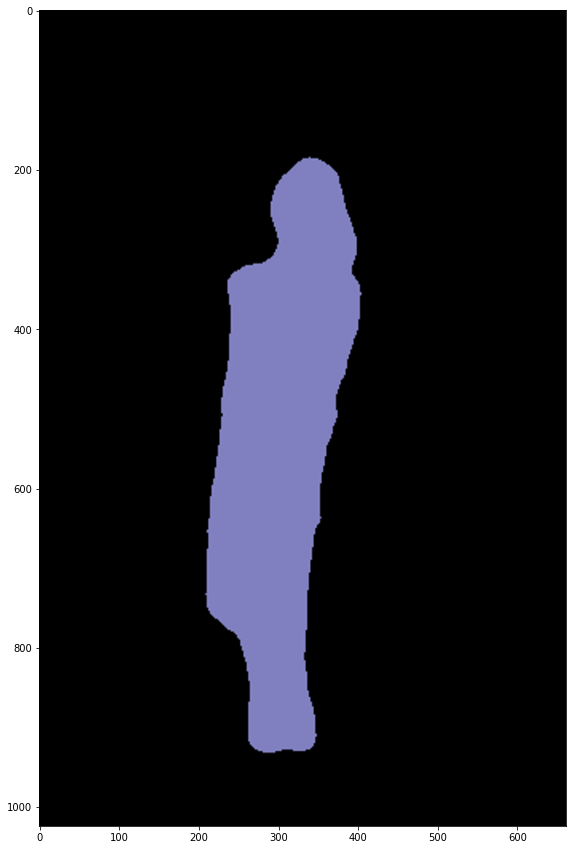

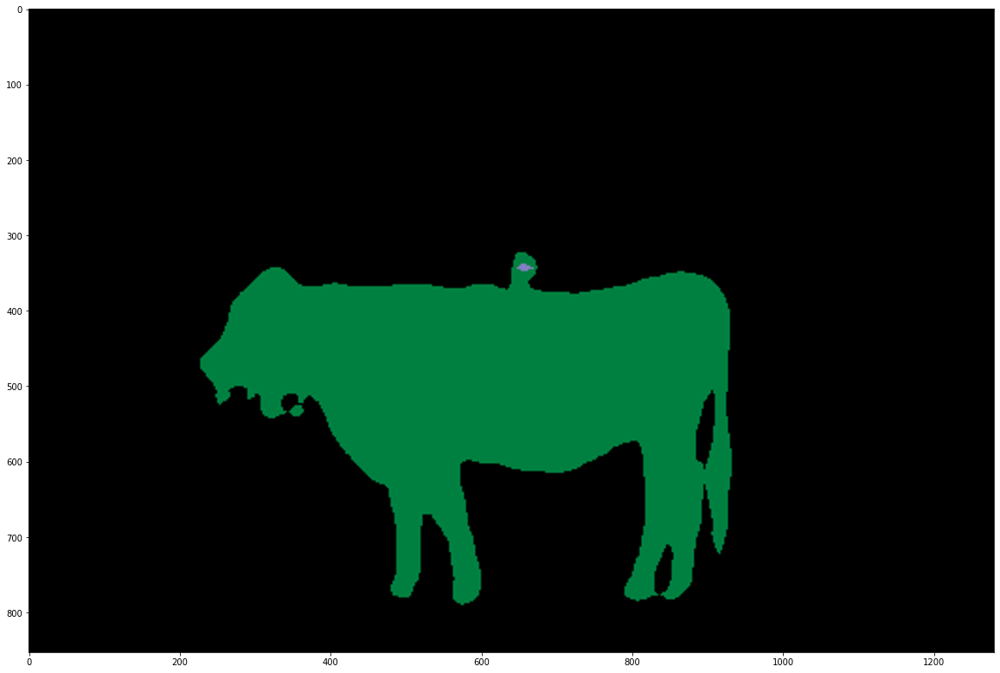

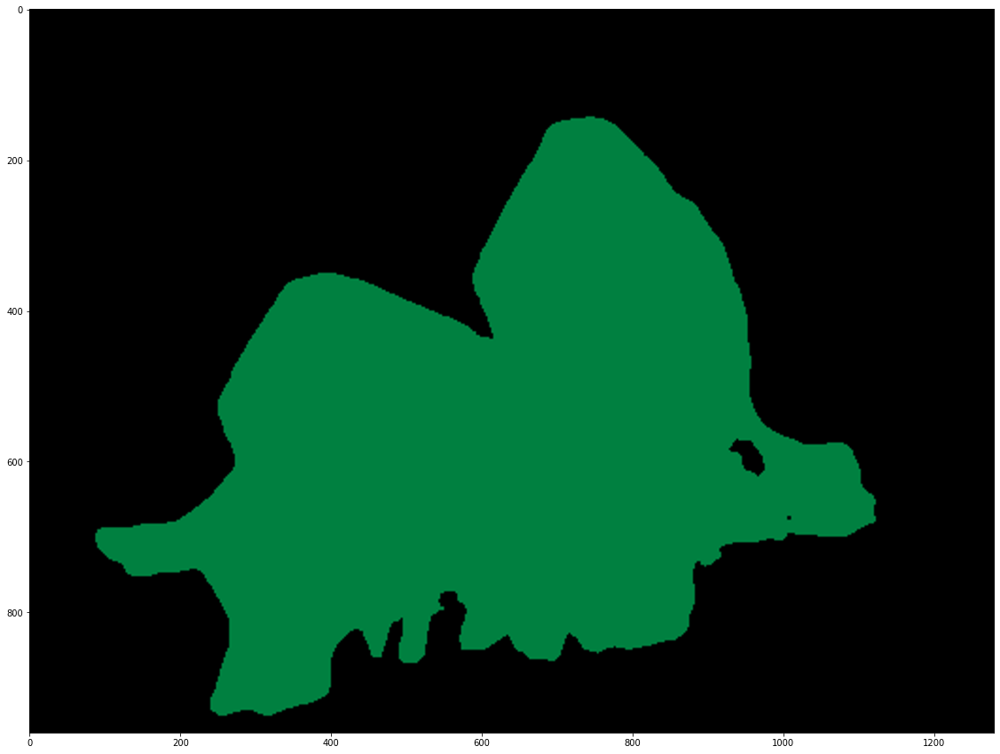

In [7]:
plt.imshow(output_1)
plt.show()
plt.imshow(output_2)
plt.show()
plt.imshow(output_3)
plt.show()
plt.imshow(output_4)
plt.show()

### 사진에서 검출된 레이블

In [8]:
for class_id in segvalues_1['class_ids']:
    print(LABEL_NAMES[class_id])
print('==========================================================')    
for class_id in segvalues_2['class_ids']:
    print(LABEL_NAMES[class_id])
print('==========================================================')    
for class_id in segvalues_3['class_ids']:
    print(LABEL_NAMES[class_id])
print('==========================================================')        
for class_id in segvalues_4['class_ids']:
    print(LABEL_NAMES[class_id])

background
boat
person
background
person
background
cow
person
background
cow


In [9]:
#img_1 에 대해

colormap_1 = np.zeros((256, 3), dtype = int)
ind_1 = np.arange(256, dtype=int)

for shift in reversed(range(8)): #2의 8승 =256 이기 때문에 8
    for channel in range(3): #읽어들인 이미지의 채널, RGB 로 3개이기때문에 3
        colormap_1[:, channel] |= ((ind_1 >> channel) & 1) << shift
    ind_1 >>= 3

colormap_1[:20] #생성한 20개의 컬러맵 출력

array([[  0,   0,   0],
       [128,   0,   0],
       [  0, 128,   0],
       [128, 128,   0],
       [  0,   0, 128],
       [128,   0, 128],
       [  0, 128, 128],
       [128, 128, 128],
       [ 64,   0,   0],
       [192,   0,   0],
       [ 64, 128,   0],
       [192, 128,   0],
       [ 64,   0, 128],
       [192,   0, 128],
       [ 64, 128, 128],
       [192, 128, 128],
       [  0,  64,   0],
       [128,  64,   0],
       [  0, 192,   0],
       [128, 192,   0]])

### 각각의 레이블에 대해 생성된 컬러맵

In [10]:
#img_2 에 대해

colormap_2 = np.zeros((256, 3), dtype = int)
ind_2 = np.arange(256, dtype=int)

for shift in reversed(range(8)): #2의 8승 =256 이기 때문에 8
    for channel in range(3): #읽어들인 이미지의 채널, RGB 로 3개이기때문에 3
        colormap_2[:, channel] |= ((ind_2 >> channel) & 1) << shift
    ind_2 >>= 3

colormap_1[:20] #생성한 20개의 컬러맵 출력

array([[  0,   0,   0],
       [128,   0,   0],
       [  0, 128,   0],
       [128, 128,   0],
       [  0,   0, 128],
       [128,   0, 128],
       [  0, 128, 128],
       [128, 128, 128],
       [ 64,   0,   0],
       [192,   0,   0],
       [ 64, 128,   0],
       [192, 128,   0],
       [ 64,   0, 128],
       [192,   0, 128],
       [ 64, 128, 128],
       [192, 128, 128],
       [  0,  64,   0],
       [128,  64,   0],
       [  0, 192,   0],
       [128, 192,   0]])

In [11]:
#img_3 에 대해

colormap_3 = np.zeros((256, 3), dtype = int)
ind_3 = np.arange(256, dtype=int)

for shift in reversed(range(8)): #2의 8승 =256 이기 때문에 8
    for channel in range(3): #읽어들인 이미지의 채널, RGB 로 3개이기때문에 3
        colormap_3[:, channel] |= ((ind_3 >> channel) & 1) << shift
    ind_3 >>= 3

colormap_3[:20] #생성한 20개의 컬러맵 출력

array([[  0,   0,   0],
       [128,   0,   0],
       [  0, 128,   0],
       [128, 128,   0],
       [  0,   0, 128],
       [128,   0, 128],
       [  0, 128, 128],
       [128, 128, 128],
       [ 64,   0,   0],
       [192,   0,   0],
       [ 64, 128,   0],
       [192, 128,   0],
       [ 64,   0, 128],
       [192,   0, 128],
       [ 64, 128, 128],
       [192, 128, 128],
       [  0,  64,   0],
       [128,  64,   0],
       [  0, 192,   0],
       [128, 192,   0]])

In [12]:
#img_4 에 대해

colormap_4 = np.zeros((256, 3), dtype = int)
ind_4 = np.arange(256, dtype=int)

for shift in reversed(range(8)): #2의 8승 =256 이기 때문에 8
    for channel in range(3): #읽어들인 이미지의 채널, RGB 로 3개이기때문에 3
        colormap_4[:, channel] |= ((ind_4 >> channel) & 1) << shift
    ind_4 >>= 3

colormap_4[:20] #생성한 20개의 컬러맵 출력

array([[  0,   0,   0],
       [128,   0,   0],
       [  0, 128,   0],
       [128, 128,   0],
       [  0,   0, 128],
       [128,   0, 128],
       [  0, 128, 128],
       [128, 128, 128],
       [ 64,   0,   0],
       [192,   0,   0],
       [ 64, 128,   0],
       [192, 128,   0],
       [ 64,   0, 128],
       [192,   0, 128],
       [ 64, 128, 128],
       [192, 128, 128],
       [  0,  64,   0],
       [128,  64,   0],
       [  0, 192,   0],
       [128, 192,   0]])

for shift in reversed(range(8)): `2의 8승 =256 이기 때문에 8`  
    for channel in range(3): `읽어들인 이미지의 채널, RGB 로 3개이기때문에 3`  
    
---
사람의 인덱스는 15, cow의 인덱스는 10이므로 해당하는 색상으로 해당하는 클래스 마스크를 뽑아낸다.

In [13]:
colormap_1[15] #label에서 person_idx = 15

colormap_2[15] #label에서 person_idx = 15

array([192, 128, 128])

In [14]:
colormap_3[10] #label에서 cow_idx = 10

colormap_4[10] #label에서 cow_idx = 10

array([ 64, 128,   0])

In [15]:
seg_color_1 = (128,128,192) #사람
seg_color_2 = (0,128,64) #카우

(768, 1024)


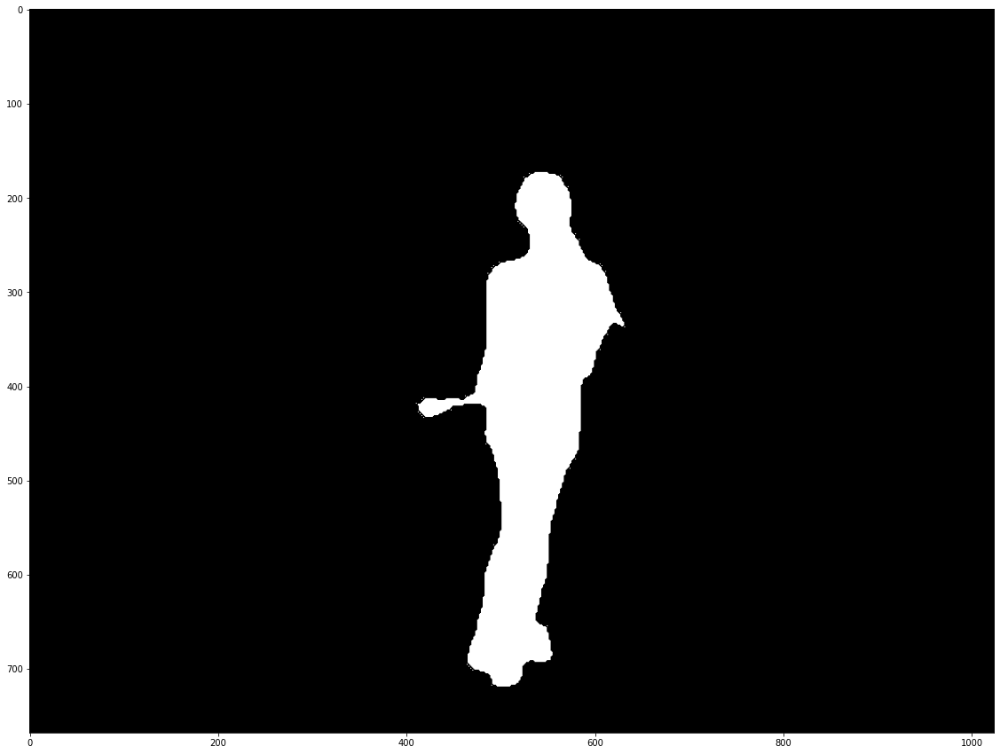

In [16]:
seg_map_1 = np.all(output_1==seg_color_1, axis=-1) 
print(seg_map_1.shape) 
plt.imshow(seg_map_1, cmap='gray')
plt.show()

(1024, 661)


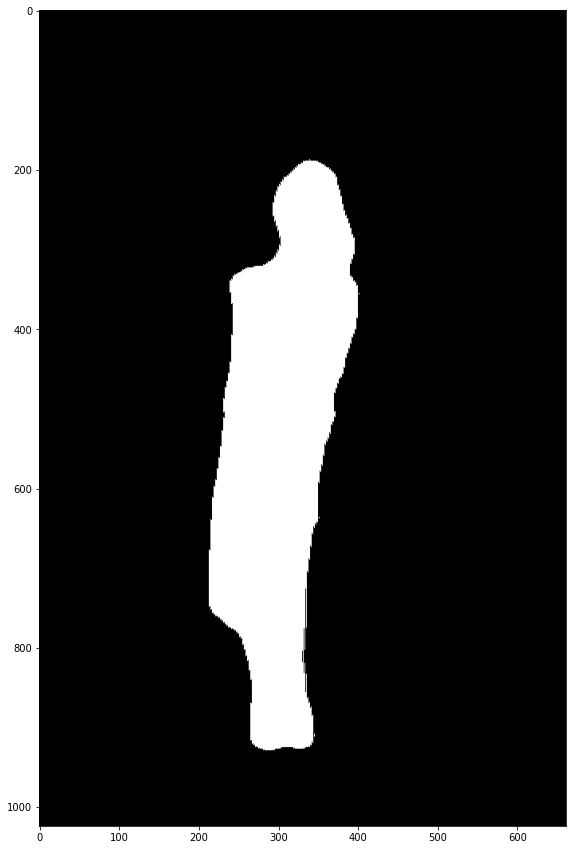

In [17]:
seg_map_2 = np.all(output_2==seg_color_1, axis=-1) 
print(seg_map_2.shape) 
plt.imshow(seg_map_2, cmap='gray')
plt.show()

(853, 1280)


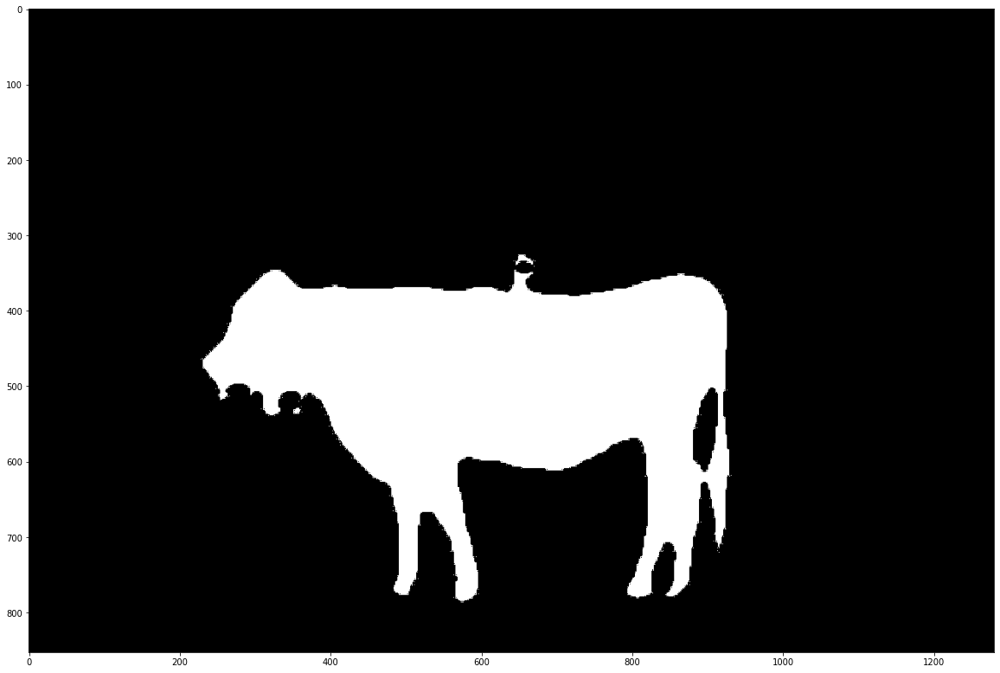

In [18]:
seg_map_3 = np.all(output_3==seg_color_2, axis=-1) 
print(seg_map_3.shape) 
plt.imshow(seg_map_3, cmap='gray')
plt.show()

(960, 1280)


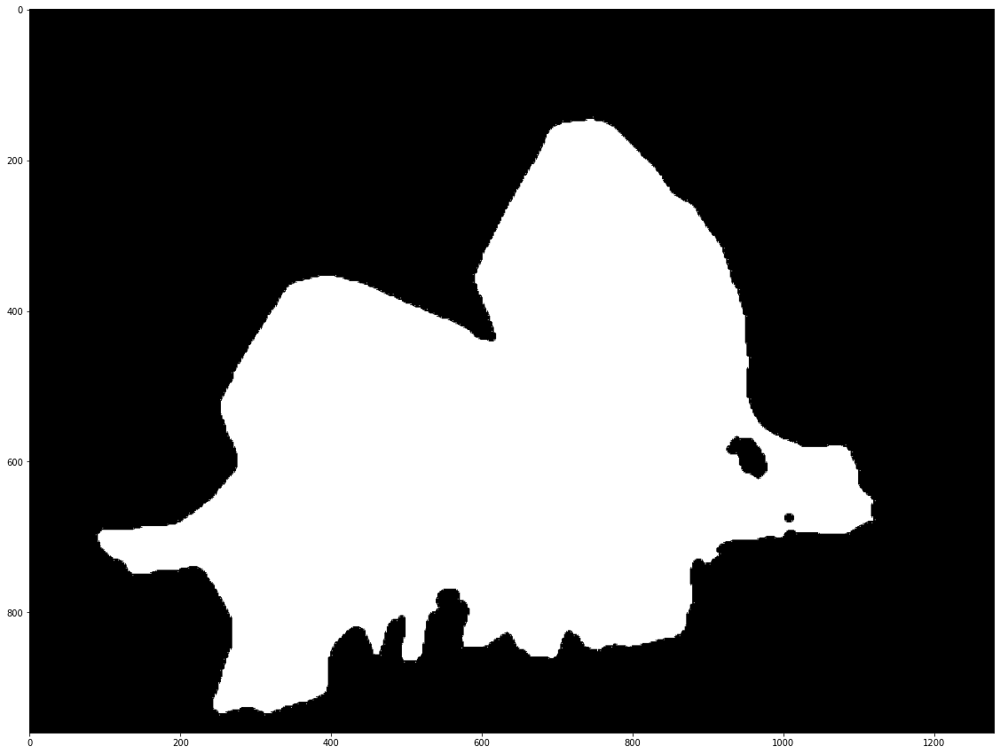

In [19]:
seg_map_4 = np.all(output_4==seg_color_2, axis=-1) 
print(seg_map_4.shape) 
plt.imshow(seg_map_4, cmap='gray')
plt.show()

### 생성된 컬러맵과 이미지를 겹쳐보기

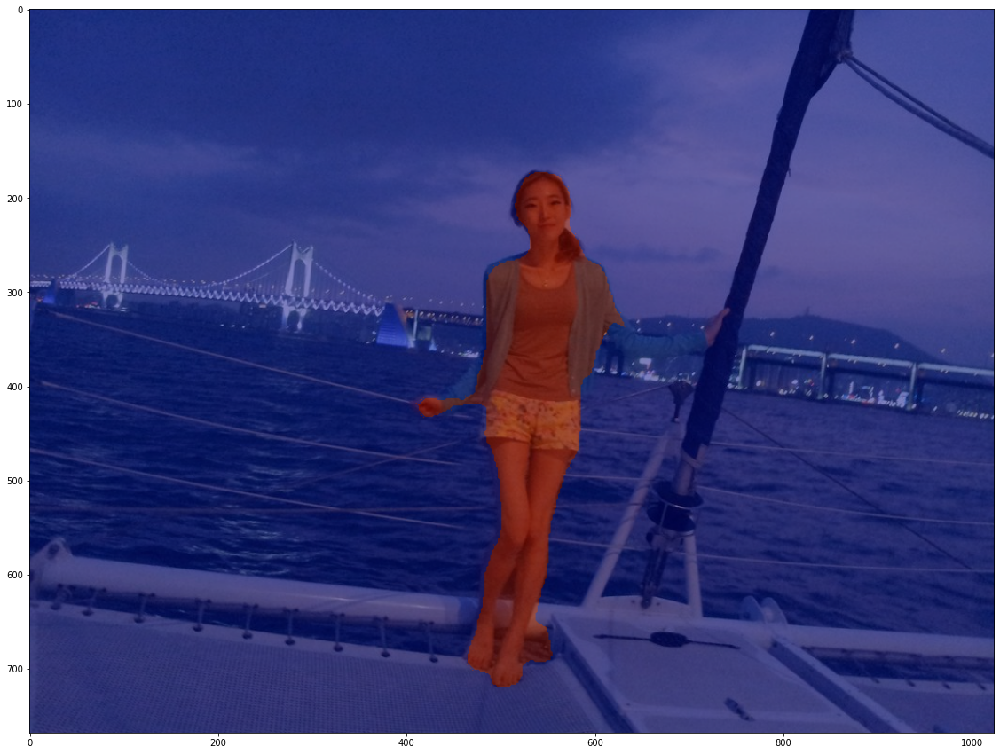

In [20]:
img_show_1 = img_orig_1.copy()
img_mask_1 = seg_map_1.astype(np.uint8) * 255
color_mask_1 = cv2.applyColorMap(img_mask_1, cv2.COLORMAP_JET)
img_show_1 = cv2.addWeighted(img_show_1, 0.5, color_mask_1, 0.5, 0.0) 
plt.imshow(cv2.cvtColor(img_show_1, cv2.COLOR_BGR2RGB))
plt.show()

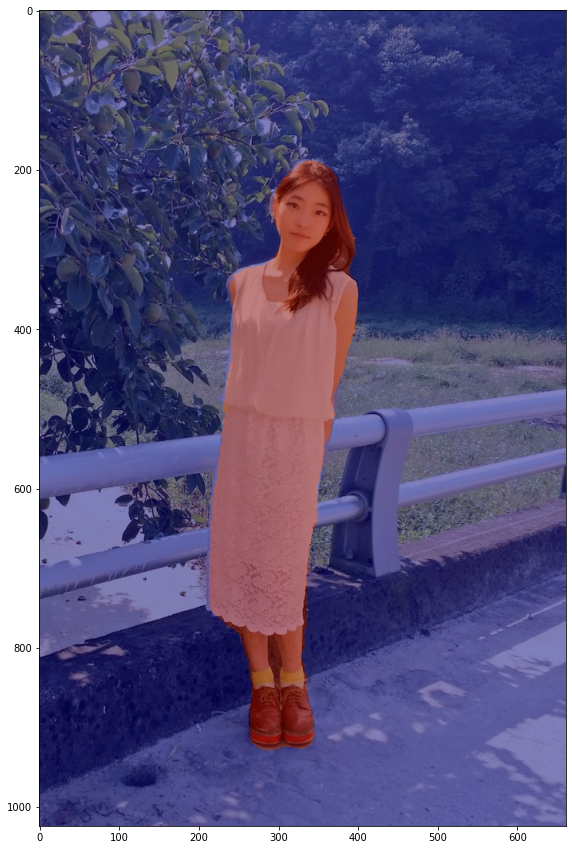

In [21]:
img_show_2 = img_orig_2.copy()
img_mask_2 = seg_map_2.astype(np.uint8) * 255
color_mask_2 = cv2.applyColorMap(img_mask_2, cv2.COLORMAP_JET)
img_show_2 = cv2.addWeighted(img_show_2, 0.5, color_mask_2, 0.5, 0.0) 
plt.imshow(cv2.cvtColor(img_show_2, cv2.COLOR_BGR2RGB))
plt.show()

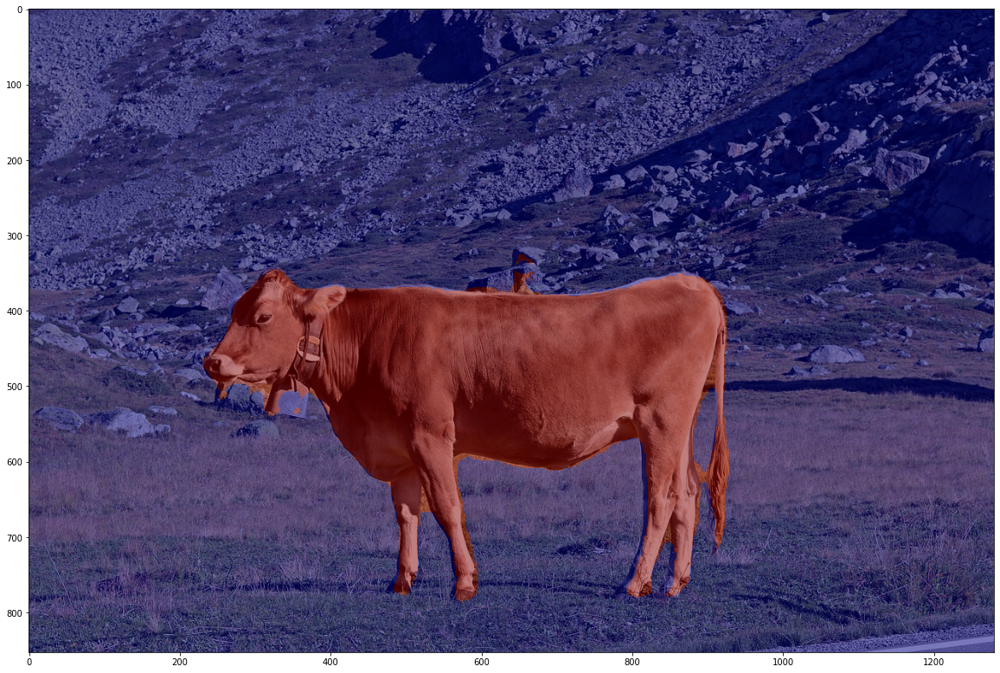

In [22]:
img_show_3 = img_orig_3.copy()
img_mask_3 = seg_map_3.astype(np.uint8) * 255
color_mask_3 = cv2.applyColorMap(img_mask_3, cv2.COLORMAP_JET)
img_show_3 = cv2.addWeighted(img_show_3, 0.5, color_mask_3, 0.5, 0.0) 
plt.imshow(cv2.cvtColor(img_show_3, cv2.COLOR_BGR2RGB))
plt.show()

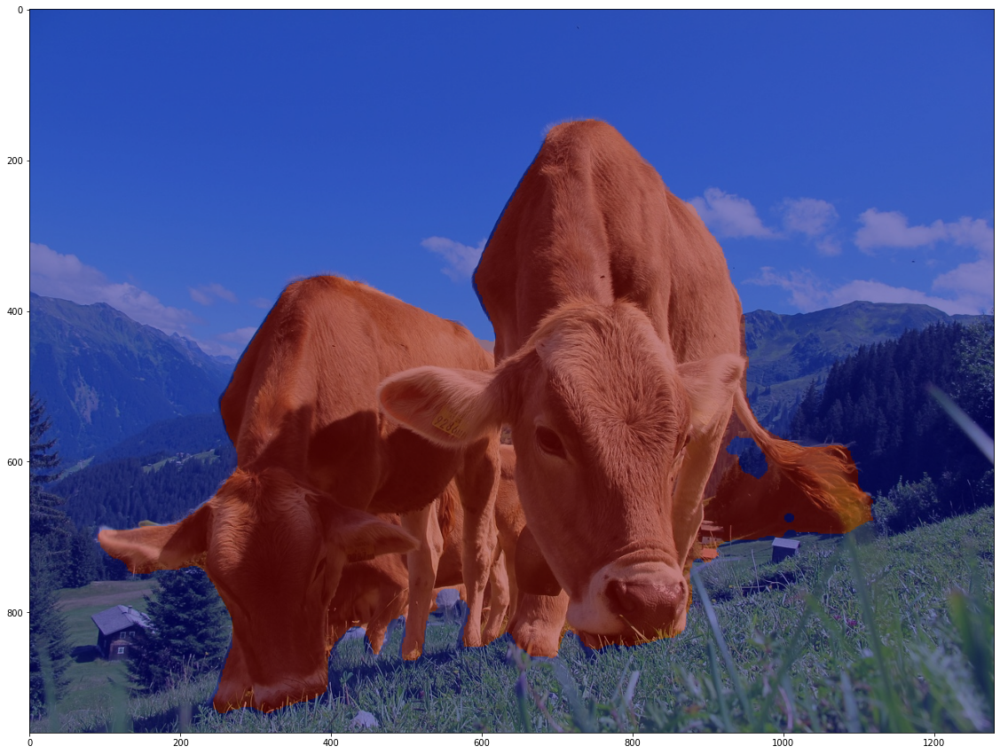

In [23]:
img_show_4 = img_orig_4.copy()
img_mask_4 = seg_map_4.astype(np.uint8) * 255
color_mask_4 = cv2.applyColorMap(img_mask_4, cv2.COLORMAP_JET)
img_show_4 = cv2.addWeighted(img_show_4, 0.5, color_mask_4, 0.5, 0.0) 
plt.imshow(cv2.cvtColor(img_show_4, cv2.COLOR_BGR2RGB))
plt.show()

### 원하는 레이블의 영역을 제외한 배경을 흐리게 하기 위한 작업   

> 1. 원본 이미지를 모두 흐리게 한다.
> 2. 흐린 그림에 원하는 영역 (이미지 컬러맵에서 원하는 레이블의 영역만 선택)을 체크한다.
> 3. 2.의 영역은 흐리지 않은 원본 이미지를 보여준다.

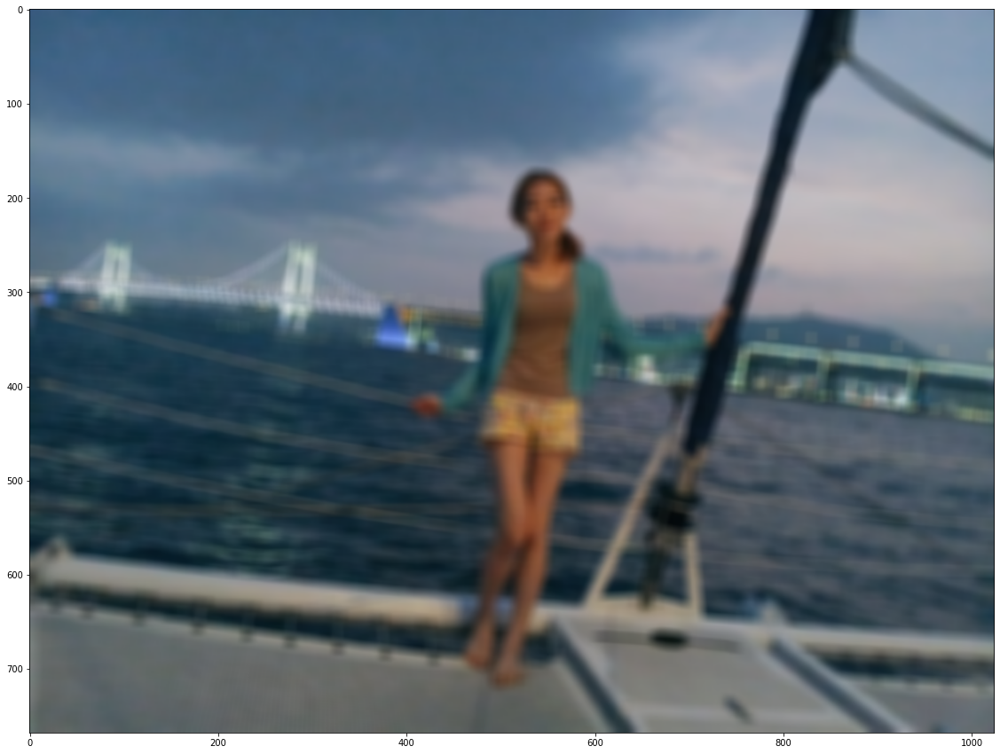

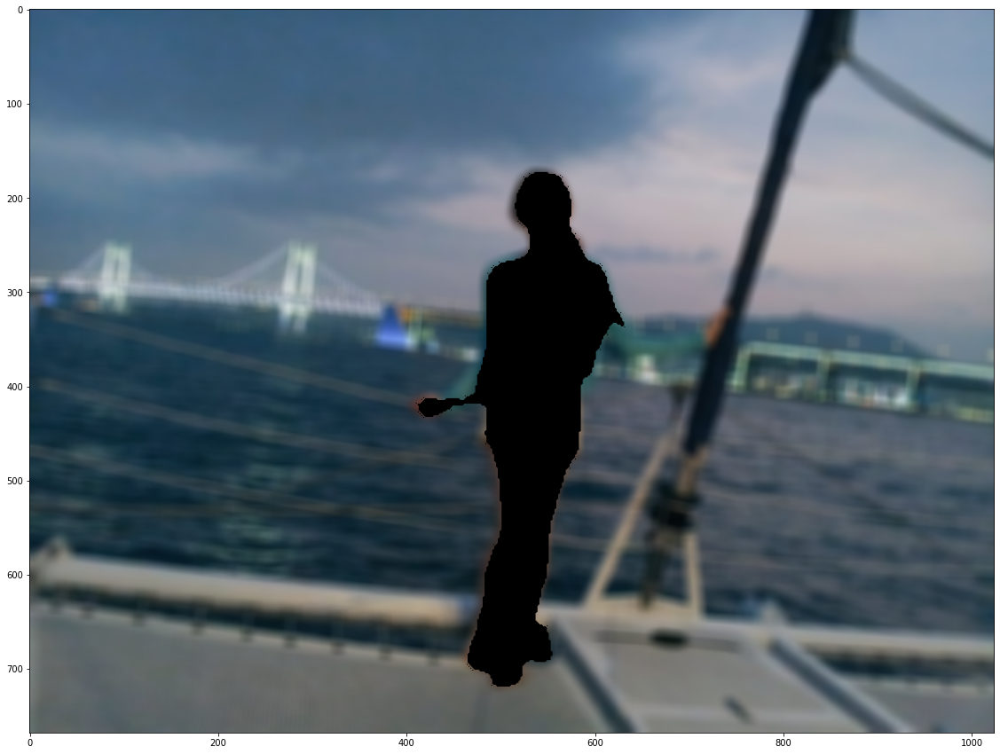

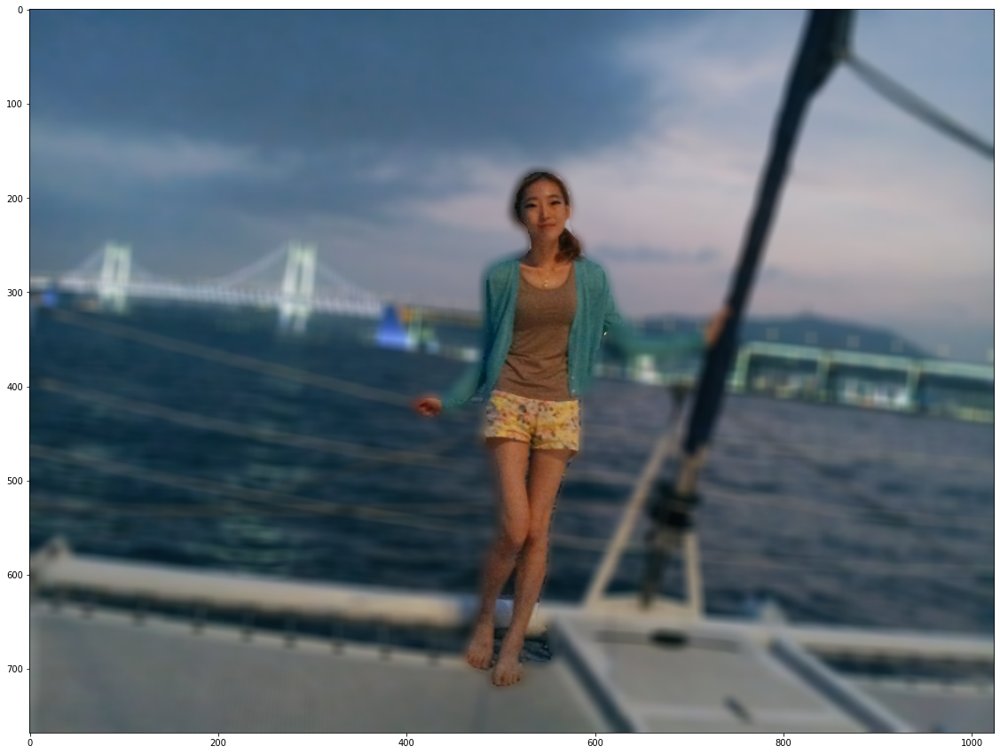

In [24]:
img_orig_blur_1 = cv2.blur(img_orig_1, (13,13))
plt.imshow(cv2.cvtColor(img_orig_blur_1, cv2.COLOR_BGR2RGB))
plt.show()

img_mask_color_1 = cv2.cvtColor(img_mask_1, cv2.COLOR_GRAY2BGR)
img_bg_mask_1 = cv2.bitwise_not(img_mask_color_1)
img_bg_blur_1 = cv2.bitwise_and(img_orig_blur_1, img_bg_mask_1)
plt.imshow(cv2.cvtColor(img_bg_blur_1, cv2.COLOR_BGR2RGB))
plt.show()

img_concat_1 = np.where(img_mask_color_1==255, img_orig_1, img_bg_blur_1)
plt.imshow(cv2.cvtColor(img_concat_1, cv2.COLOR_BGR2RGB))
plt.show()

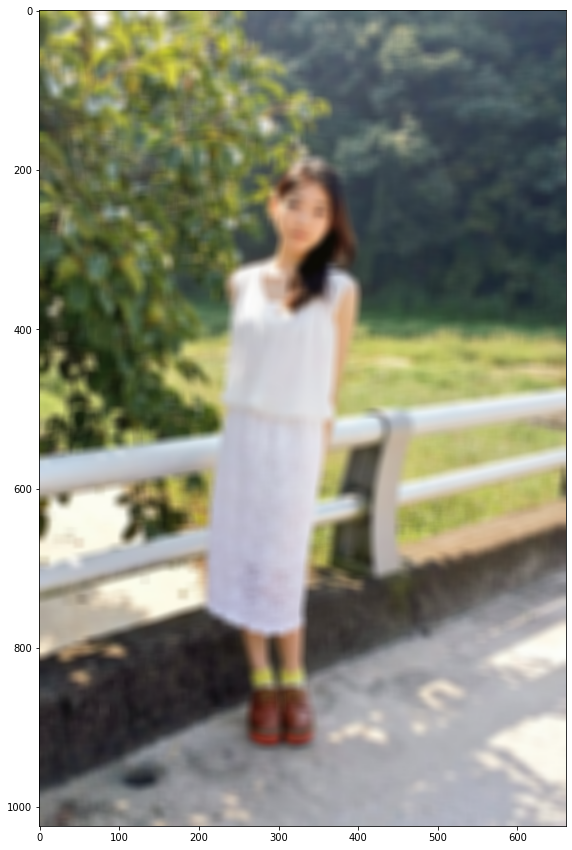

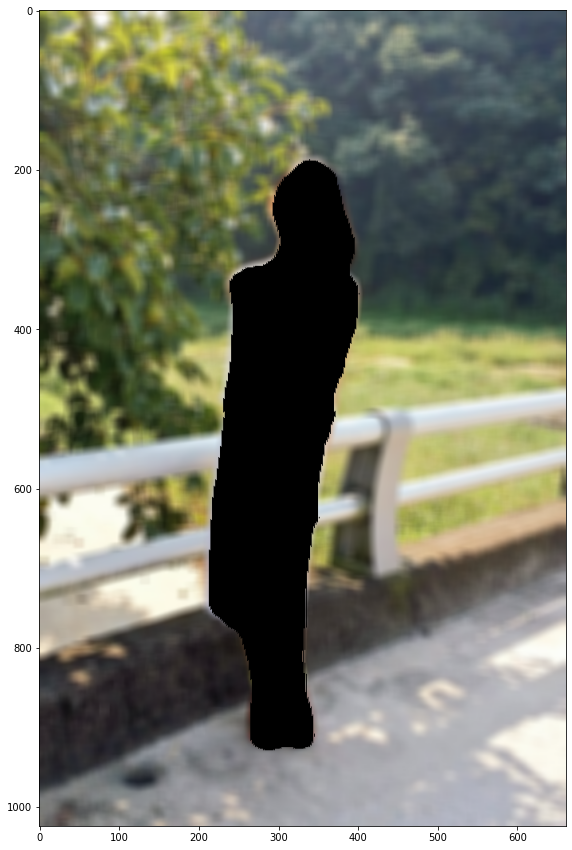

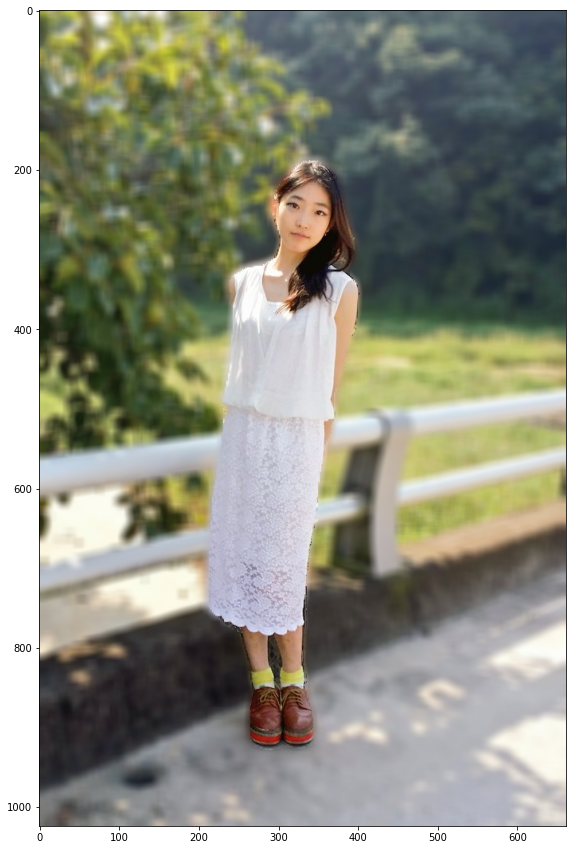

In [25]:
img_orig_blur_2 = cv2.blur(img_orig_2, (13,13))
plt.imshow(cv2.cvtColor(img_orig_blur_2, cv2.COLOR_BGR2RGB))
plt.show()

img_mask_color_2 = cv2.cvtColor(img_mask_2, cv2.COLOR_GRAY2BGR)
img_bg_mask_2 = cv2.bitwise_not(img_mask_color_2)
img_bg_blur_2 = cv2.bitwise_and(img_orig_blur_2, img_bg_mask_2)
plt.imshow(cv2.cvtColor(img_bg_blur_2, cv2.COLOR_BGR2RGB))
plt.show()

img_concat_2 = np.where(img_mask_color_2==255, img_orig_2, img_bg_blur_2)
plt.imshow(cv2.cvtColor(img_concat_2, cv2.COLOR_BGR2RGB))
plt.show()

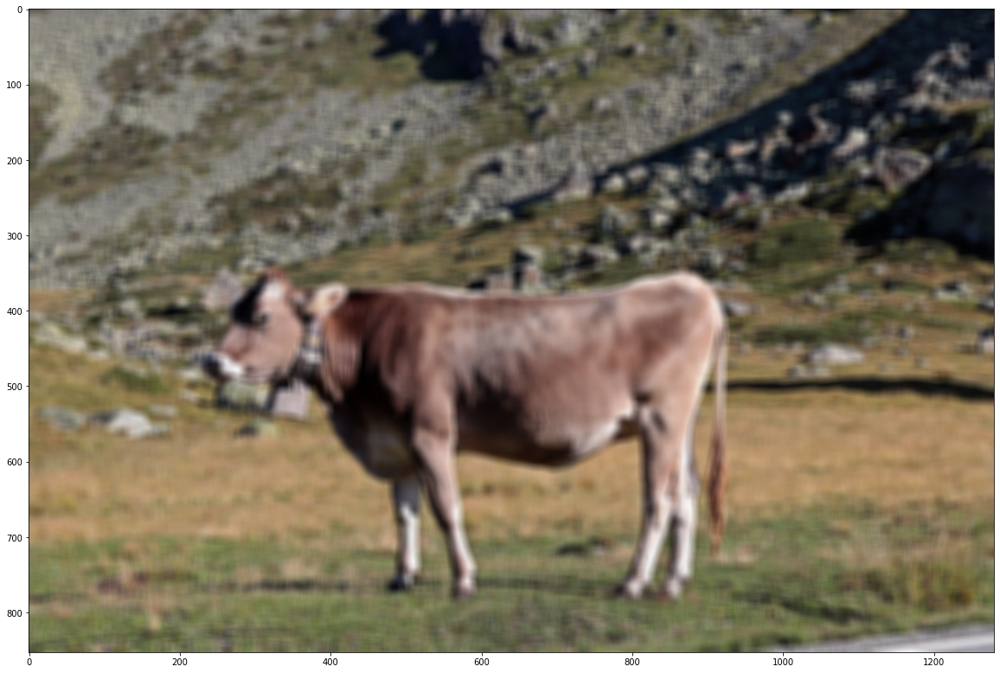

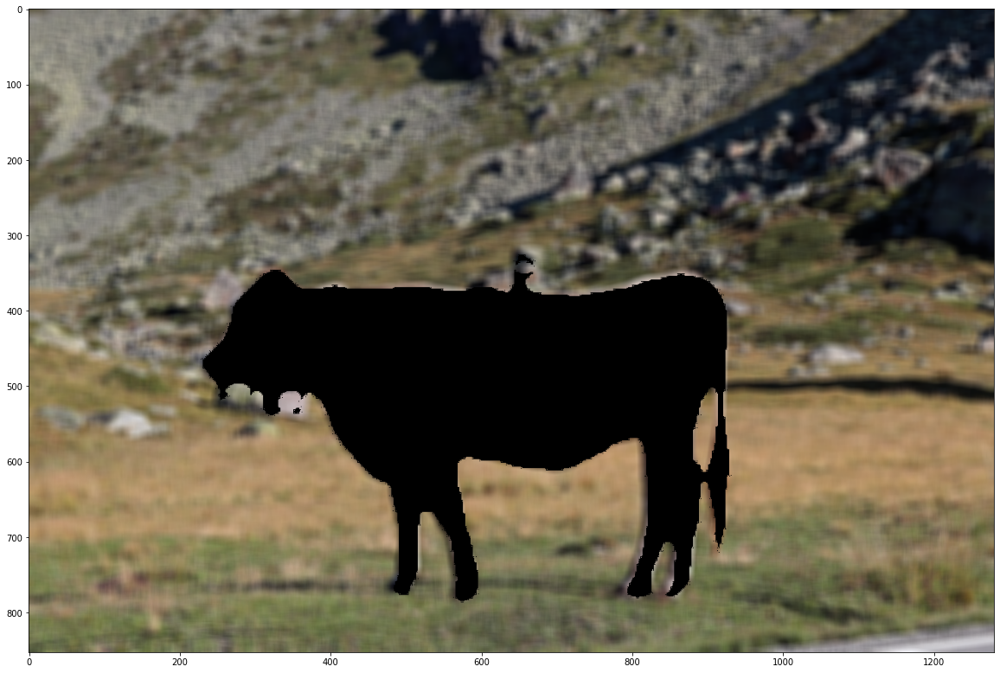

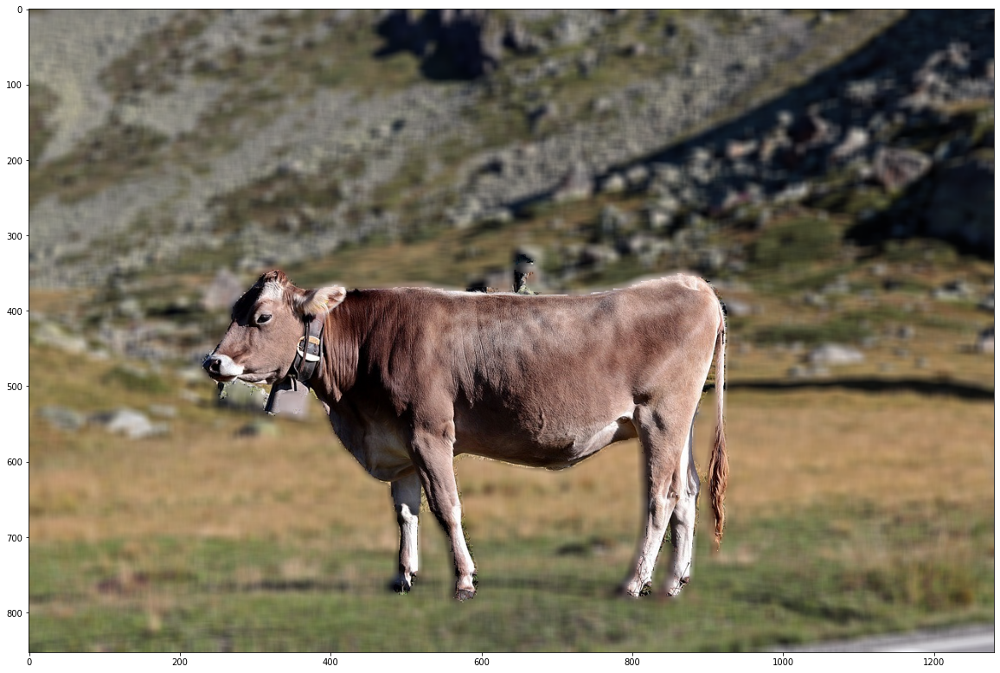

In [26]:
img_orig_blur_3 = cv2.blur(img_orig_3, (13,13))
plt.imshow(cv2.cvtColor(img_orig_blur_3, cv2.COLOR_BGR2RGB))
plt.show()

img_mask_color_3 = cv2.cvtColor(img_mask_3, cv2.COLOR_GRAY2BGR)
img_bg_mask_3 = cv2.bitwise_not(img_mask_color_3)
img_bg_blur_3 = cv2.bitwise_and(img_orig_blur_3, img_bg_mask_3)
plt.imshow(cv2.cvtColor(img_bg_blur_3, cv2.COLOR_BGR2RGB))
plt.show()

img_concat_3 = np.where(img_mask_color_3==255, img_orig_3, img_bg_blur_3)
plt.imshow(cv2.cvtColor(img_concat_3, cv2.COLOR_BGR2RGB))
plt.show()

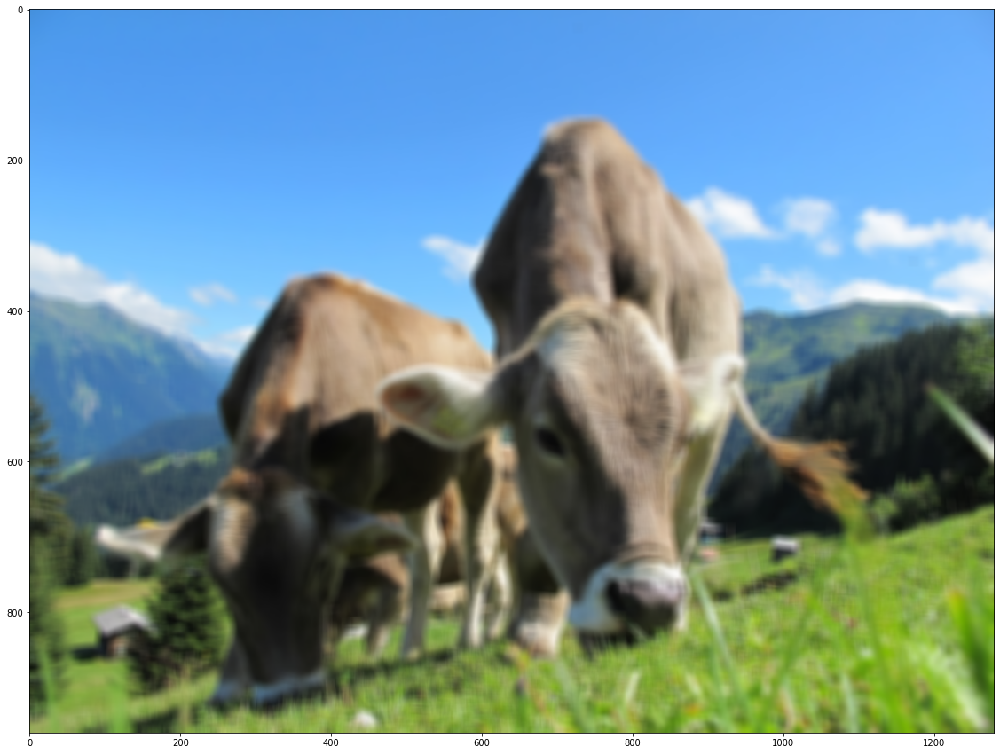

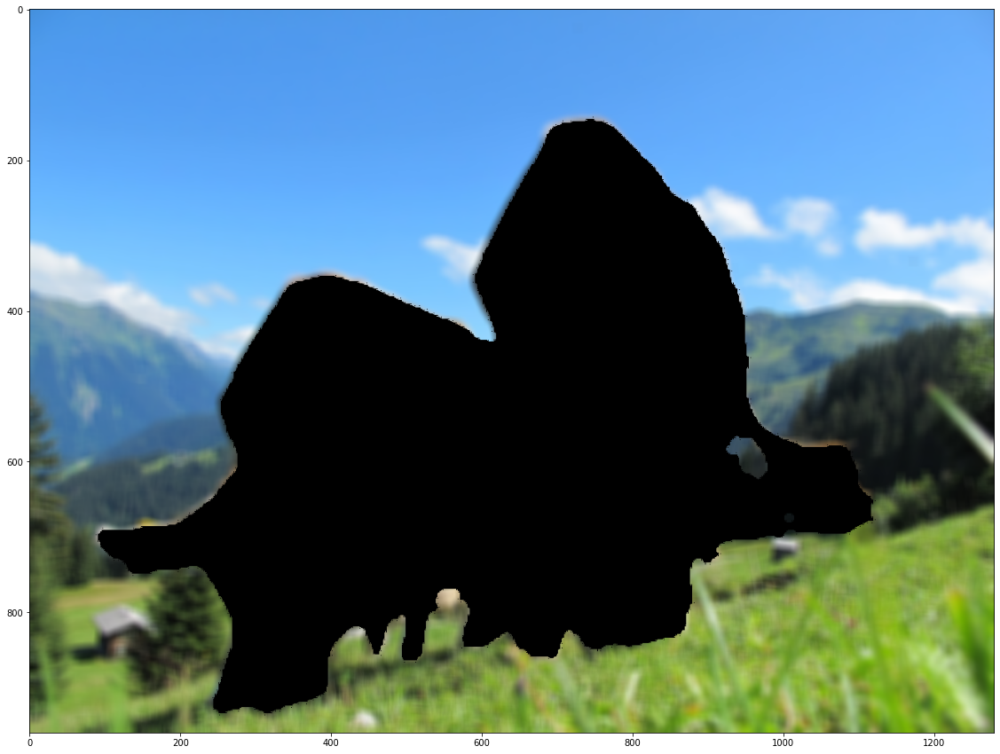

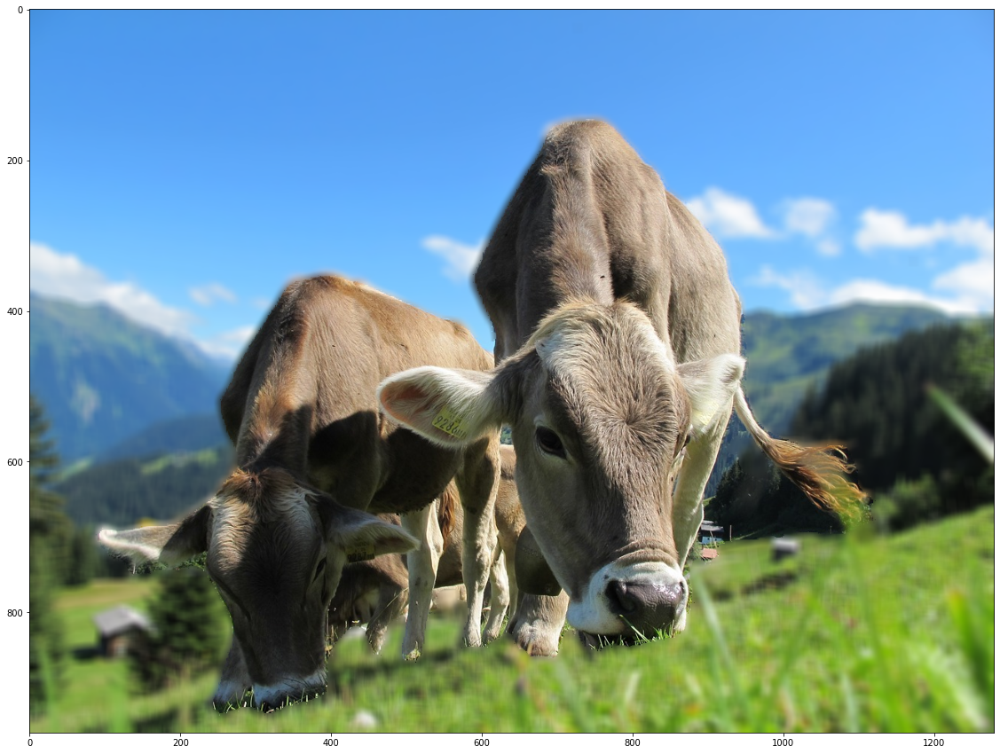

In [27]:
img_orig_blur_4 = cv2.blur(img_orig_4, (13,13))
plt.imshow(cv2.cvtColor(img_orig_blur_4, cv2.COLOR_BGR2RGB))
plt.show()

img_mask_color_4 = cv2.cvtColor(img_mask_4, cv2.COLOR_GRAY2BGR)
img_bg_mask_4 = cv2.bitwise_not(img_mask_color_4)
img_bg_blur_4 = cv2.bitwise_and(img_orig_blur_4, img_bg_mask_4)
plt.imshow(cv2.cvtColor(img_bg_blur_4, cv2.COLOR_BGR2RGB))
plt.show()

img_concat_4 = np.where(img_mask_color_4==255, img_orig_4, img_bg_blur_4)
plt.imshow(cv2.cvtColor(img_concat_4, cv2.COLOR_BGR2RGB))
plt.show()

### 크로마키 배경 합성

In [28]:
print(img_orig_1.shape)
print(img_orig_2.shape)
print(img_orig_3.shape)
print(img_orig_4.shape)


(768, 1024, 3)
(1024, 661, 3)
(853, 1280, 3)
(960, 1280, 3)


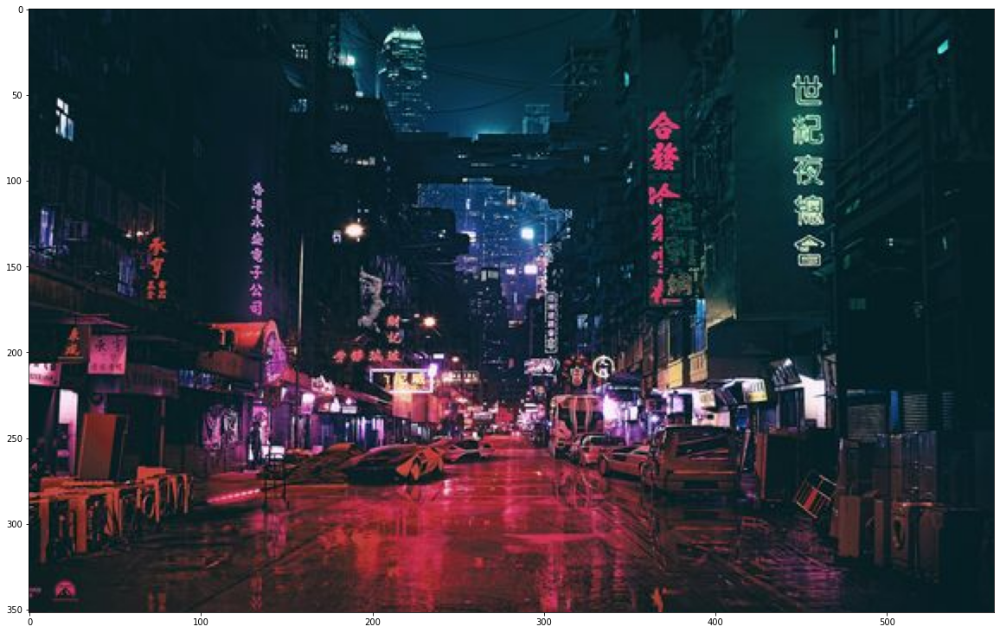

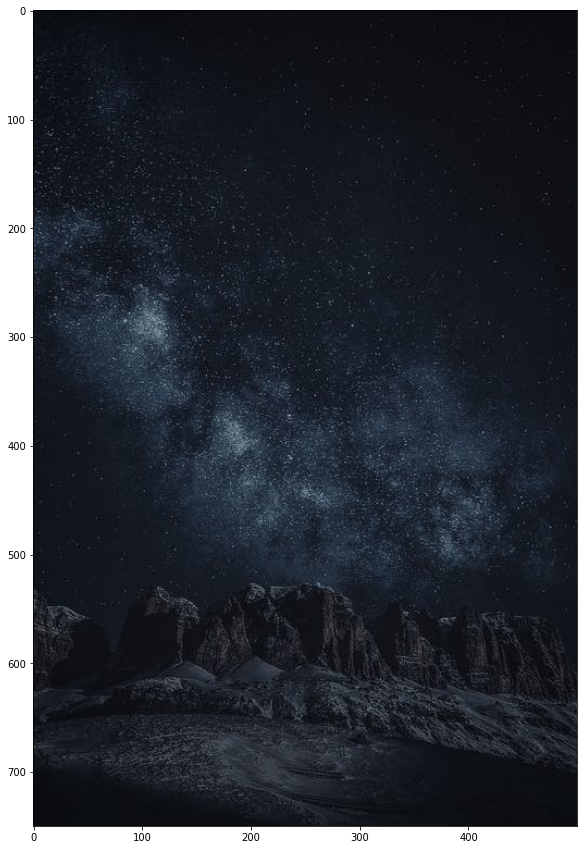

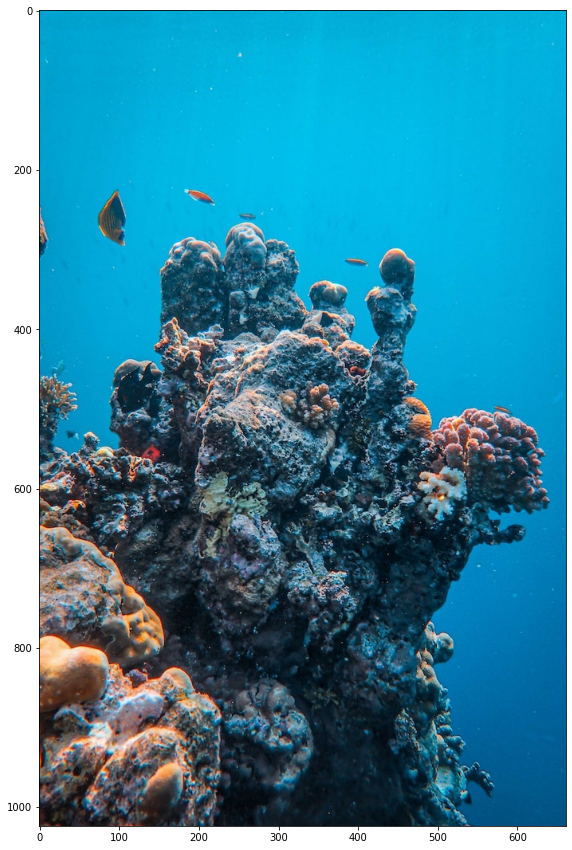

In [29]:
bg_path_1 = 'img/bg1.jpg'
bg_path_2 = 'img/bg2.jpeg'
bg_path_3 = 'img/bg3.jpg'
bg_1 = cv2.imread(bg_path_1)
bg_2 = cv2.imread(bg_path_2) 
bg_3 = cv2.imread(bg_path_3) 

plt.imshow(cv2.cvtColor(bg_1, cv2.COLOR_BGR2RGB))
plt.show()
plt.imshow(cv2.cvtColor(bg_2, cv2.COLOR_BGR2RGB))
plt.show()
plt.imshow(cv2.cvtColor(bg_3, cv2.COLOR_BGR2RGB))
plt.show()

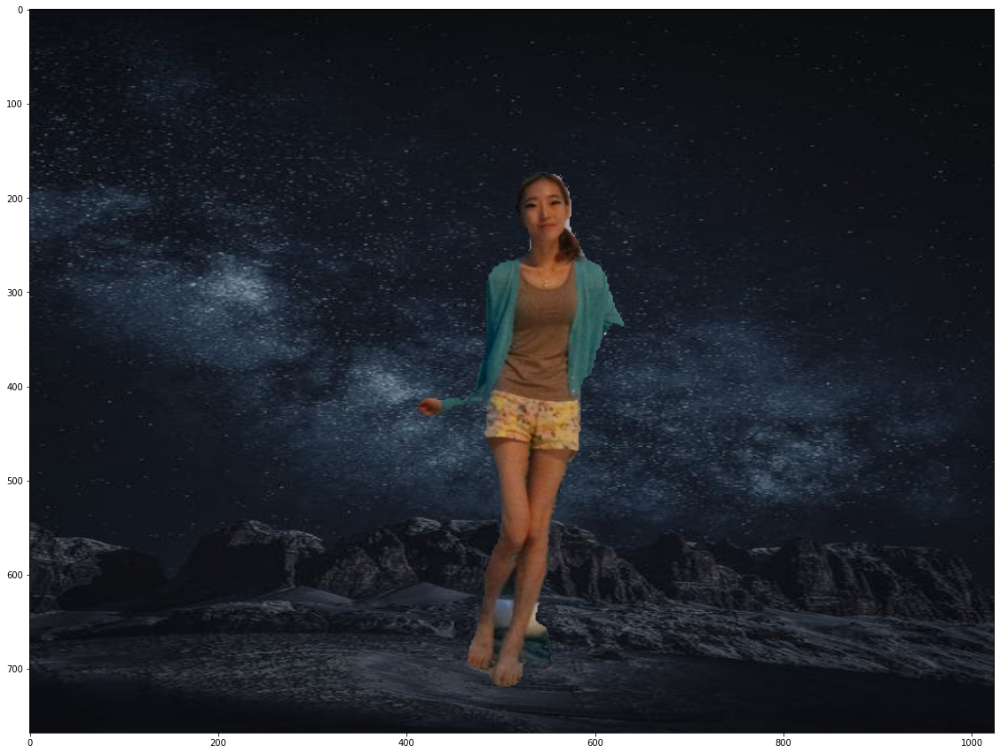

In [ ]:
bg_resized_2 = cv2.resize(bg_2, (1024, 768))
img_concat_bg_1 = np.where(img_mask_color_1==255, img_orig_1, bg_resized_2)
plt.imshow(cv2.cvtColor(img_concat_bg_1, cv2.COLOR_BGR2RGB))
plt.show()

bg_resized_1 = cv2.resize(bg_1, (1280, 853))
img_concat_bg_2 = np.where(img_mask_color_3==255, img_orig_3, bg_resized_1)
plt.imshow(cv2.cvtColor(img_concat_bg_2, cv2.COLOR_BGR2RGB))
plt.show()

bg_resized_3 = cv2.resize(bg_3, (661, 1024))
img_concat_bg_3 = np.where(img_mask_color_2==255, img_orig_2, bg_resized_3)
plt.imshow(cv2.cvtColor(img_concat_bg_3, cv2.COLOR_BGR2RGB))
plt.show()



###  사진에서 문제점 찾기 

![](img/eval1.png)

> 1. 전체적으로 경계선에서 문제가 발생했다.  
> 2. 또는 가는 부분 사이의 배경은 뭉뚱그려 사람으로 인식하기도 했다.  
> 3. 배경과 비슷한 색상에서 혼동이 발생한다.  
> 4. 인물에서 작게 돌출된 부분 (귀, 손끝, 머리카락 아웃라인 등)의 인식이 섬세하지 않아 부자연스럽다.


## 개선방안 아이디어 & Discussions  

문제점이 발생하는 가장 근본적인 원인은, 이미지에서 깊이감(depth)를 제대로 읽어낼 수 없기 때문이다.  
즉, 사진은 평면적으로 표현된 값이지만 사실 그것은 입체적인 공간에서 비롯된 것이다.  
사람의 눈은 두개이다. 즉 렌즈가 두개이며 각각의 렌즈가 맺은 상의 차이를 뇌는 인식하여 원근감을 쉽게 가질 수 있다.  
이런 원리에 착안하여 카메라가 여러개 달려있는 스마트폰은 쉽게 섈로우 포커스를 구현할 수 있다.  
하지만 이는 서로 다른 렌즈(적절한 거리가 있는)을 필요로 하고 초소형 카메라에 어울리지 않는다.  

**i)**

실제 계에서 깊이감 있게 인식을 하는 문제와 (3d 센서링, 3d 카메라, 하드웨어적- 또는 '인식과정'에서의 소프트웨어적 방법)  
우리가 수행한 과제 개선방향은 조금 다를 수도 있다는 생각을 했다.  
우리가 판단하는 것은 이미 평면화된 '사진'에서 깊이감을 알 수 있어야 하는 것이기 때문이다.   
그래서 오히려 3d 센서링 문제보다는 image captionaing과 본질적으로 비슷한 문제라고 생각했다.

image captioning 은 cnn을 이용한 이미지 디텍팅, 피처 익스트랙팅을 한다. 그 후 attention network로 이미지 내에서 주요한 부분의 가중치를 높인다. 그 후 LSTM을 이용해 문장을 생성하게 되는데 내가 가장 주목한 부분은 attention network 이다. (ref.2) 
특히 soft-attention 을 가지는 모델은 이미지에서 주요한 부분과 그 주변의 관계성을 조금 더 유연하게 집중하게 되는 것 같다.  
이런 부분을 오늘의 과제에 적용해 본다면, 
이미지를 읽어들일 때 이런 attention의 개념 (주요한 부분에 집중하는) 에서 착안한 아이디어를 낼 수 있다.  
> 1) 이미지를 읽어들인다.  
> 2) 이미지에서 주요한 부분을 찾아낸다 (attention)
> 3) 주요한 부분 주변의 픽셀들은(margin 설정) 조금 더 세세하게 edge(또는 명암, 그림자)를 feature extract 한다. 
> 4) + texture 필터로 경계를 판단.

평면에서 depth를 인식하기 위해서는 결국 거리차에 의한 음영(그림자, 겹쳐짐에 의한 빛 거리감 차이)를 인식할 수 있어야 한다고 생각했다.  
그러나 만일 이미지의 모든 부분에서 이렇게 미세한 것까지 포착하려 하다가는 오히려 세그멘테이션이 더 부정확할 수 있다.  
따라서 attention이 가는 부분(들)과 그 주변만을 다른 필터 (또는 더 미세한 것까지 포착하는 HoG 방식 등)을 사용할 수는 없을까 생각을 했다.  

**ii)**

우리는 일단 한 번 segmentation을 수행하고 픽셀마다 해당하는 레이블을 가지게 된다. (사람 사진의 경우에는 person)  
그러면 첫번째 수행에서 person 이라고 레이블링 되어 생성된 마스크를 가져오면 그 안에는 사람도 있고 사람은 아니지만 같이 섞이게 된 것도 있을 것이다.   

한차례 사람이라고 인식이 된 후에, 사람과 같이 걸리게 되는 사람아닌 것들은 일단은 사람처럼 인식이 되었기 때문에 묶인 것이다. 기본적으로 주변의 '사람'과 어느정도 유사도가 있다. 예를 들면 이어폰과 같이 small miscellaneous stuffs 또는 인물의 옷이나 살색과 유사한 배경의 요소 (뒤에 걸린 옷, 배경색깔 등)  

생각해보게 된 아이디어는 여기서 다른 모델을 한 번 더 쓰는 것이다.  
두번째 쓰는 모델을 picky한 것까지 잡아낼 수 있는 모델으로 설정할 수 있다. 이 두번째 모델은 학습 자체를 이런 미세하거나 유사한 요소들이 있는 '사람' 데이터로 함으로써 만들 수 있다.
texture나, edge나 그런 걸 좀 더 디테일하게 잡아낼 수 있게 학습을 한 모델.
(만일 이 두번째 '미세한 것을 보는' 모델을 첫번째(person을 다른 것들에서 떼는) 작업에 쓰면 오히려 좋지 않을 것이다.)
그런데 이미 적절히 person 이라고 태그 된 것 안에서 조금 더 미세하게 바라본다면? 어쩌면 효과가 있을 수도!

모델2는 조금 더 미세한, 사람이 차고 있는 시계, 머플러, 이어폰, 모자, 귀걸이 등등에 대한 데이터를 많이 가지고 있어야 할 것이다.  
+ OUTPUT을 다시 INPUT으로 받아들이는 RNN 구조가 힌트가 될 수 있다고도 생각. (한번 레이블링 -> 그에 의한 가중치를 얻어 다시 한 번)

** 결국 깊이를 인식하기  

1. 물체를 찍을 때부터 거리감있게 받아들이기 ex) 두개의 렌즈, 렌즈간 focus 다르게, -> 우리의 경우는 이미 찍힌 평면 사진으로 분석을 하기 시작하기 때문에 조금 다른 경우라고 생각. 

2. 찍힌 평면 물체에서부터 '더 가까이 있는 것' 혹은 더 '주요한' 것들을 찾아 내기.
-> image captioning 과 비슷한 맥락을 가질 수 있다고 생각.



## References

- ref 1 : 인물사진을 만들어 보자, aiffel course Going Deeper_CR2, AIFFEL  
- ref 2 : Show, Attend and Tell: Neural Image Caption Generation with Visual Attention, rXiv:1502.03044v3 [cs.LG] 19 Apr 201
- https://www.adobe.com/kr/creativecloud/photography/discover/shallow-depth-of-field.html (shallow-depth-of-field 이해)   
- https://news.skhynix.co.kr/post/next-gen-3d (3d 이미지센서)  
- https://89douner.tistory.com/296?category=878997 (처음 딥러닝을 적용한 모델 FCN에 관해)  